<a href="https://colab.research.google.com/github/Nabajyoti4/Tea-Leaves-disease-detection-with-Object-detection/blob/main/SSD_MOBILENET_V2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Download The Object Detection Model with Checkpoints

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
DATA_DIR = "/content/drive/MyDrive/Tea-Leaves-Disease-Detection/Data/"
MAIN_DIR = "/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/"
MODEL_DIR = MAIN_DIR + "ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/"
CONFIG_FILE = MODEL_DIR + "pipeline.config"
CHECKPOINT_PATH = MODEL_DIR + "checkpoint/ckpt-0"

In [ ]:
!wget 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz'
!mv '/content/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz' {MAIN_DIR}
!cd {MAIN_DIR} && tar -zxvf ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz

--2021-03-27 13:37:32--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.142.128, 2607:f8b0:400e:c08::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.142.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20518283 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.57M  --.-KB/s    in 0.1s    

2021-03-27 13:37:32 (143 MB/s) - ‘ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz’ saved [20518283/20518283]

ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8

## Download the object detection repo from github

In [ ]:
!cd {MAIN_DIR} && git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 1623, done.
remote: Counting objects: 100% (1623/1623), done.
remote: Compressing objects: 100% (760/760), done.
remote: Total 55592 (delta 989), reused 1373 (delta 848), pack-reused 53969
Receiving objects: 100% (55592/55592), 572.36 MiB | 18.57 MiB/s, done.
Resolving deltas: 100% (38058/38058), done.
Checking out files: 100% (2394/2394), done.


## Complie the obect detection files using protobuf

In [ ]:
%%bash
cd /content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp37-none-any.whl size=1643278 sha256=5393c580a71a370cc4f735ed9d1c21ad4d159dac5df39f962ec68b5f015a57ab
  Stored in directory: /tmp/pip-ephem-wheel-cache-wmmwn7ah/wheels/f8/ba/f4/35f03b0b83d8e93ad2c102df74ee52d314de94ed0f3649dfb1
  Created wheel for avro-python3: filename=avro_python3-1.10.2-cp37-none-any.whl size=44011 sha256=71deb302551950a289a3f52f3af8b281918947f375b8629ddf9ba45e201f9b69
  Stored in directory: /root/.cache/pip/wheels/ee/ee/18/c466221ca6900e3efce2f4ea9c329288808679aecdcb2838d3
  Created wheel for dill: filename=dill-0.3.1.1-cp37-none-any.whl size=78532 sha256=a691099f8ff2f3c1b1831ee53ca5a8c9ee0b5ac047c44e4c84398ed164949565
  Stored in directory: /root/.cache/pip/wheels/59/b1/91/f02e76c732915c4015ab4010f3015469866c1eb9b14058d8e7
  Created wheel for future: filename=future-0.18.2-cp37-none-any.whl siz

ERROR: multiprocess 0.70.11.1 has requirement dill>=0.3.3, but you'll have dill 0.3.1.1 which is incompatible.
ERROR: google-colab 1.0.0 has requirement requests~=2.23.0, but you'll have requests 2.25.1 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: apache-beam 2.28.0 has requirement avro-python3!=1.9.2,<1.10.0,>=1.8.1, but you'll have avro-python3 1.10.2 which is incompatible.


## Create labelmap
* Not runnable

In [ ]:
labels = [{ 
	name:'Helopeltis'
	id:1
}
{ 
	name:'Red Sipder Mite'
	id:2
}

 { 
	name:'Red_Rust'
	id:3
}
]

with open('labelmap.pbtxt', 'w') as f:
    for label in labels:
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(label['name']))
        f.write('\tid:{}\n'.format(label['id']))
        f.write('}\n')

## Generate TF Record files for train and test
* Not runnable

In [ ]:
!python {'generate_tfrecord.py'} -x {'images/train'} -l {'labelmap.pbtxt'} -o train.record
!python {'generate_tfrecord.py'} -x {'images/test'} -l {'labelmap.pbtxt'} -o test.record

## Import the neccasary models needed to train the model 

In [ ]:
import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline

## Config the downloaded model pipeline file

In [ ]:
CUSTOM_MODEL_NAME = 'ssd_mobilenet_v2' 

In [ ]:
!mkdir {MAIN_DIR+CUSTOM_MODEL_NAME}
!cp {CONFIG_FILE} {MAIN_DIR+CUSTOM_MODEL_NAME}

### Import the modules for writting to the config file

In [ ]:
import tensorflow as tf
from object_detection.utils import config_util
from object_detection.protos import pipeline_pb2
from google.protobuf import text_format

In [ ]:
CUSTOM_PIPELINE = MAIN_DIR+CUSTOM_MODEL_NAME+"/pipeline.config"

In [ ]:
config = config_util.get_configs_from_pipeline_file(CUSTOM_PIPELINE)

### Read the config file

In [ ]:
pipeline_config = pipeline_pb2.TrainEvalPipelineConfig()
with tf.io.gfile.GFile(CUSTOM_PIPELINE, "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline_config)  

### Set the neccasry configuration in config file
** Add `shuffle=False` manually in pipeline file at train_input_reader **

In [ ]:
pipeline_config.model.ssd.num_classes = 3
pipeline_config.train_config.batch_size = 10
pipeline_config.train_config.fine_tune_checkpoint = CHECKPOINT_PATH
pipeline_config.train_config.fine_tune_checkpoint_type = "detection"
pipeline_config.train_input_reader.label_map_path= DATA_DIR + 'labelmap.pbtxt'
pipeline_config.train_input_reader.tf_record_input_reader.input_path[:] = [DATA_DIR + 'train1.record',
                                                                           DATA_DIR + 'train2.record',DATA_DIR + 'train3.record']
pipeline_config.eval_input_reader[0].label_map_path = DATA_DIR + 'labelmap.pbtxt'
pipeline_config.eval_input_reader[0].tf_record_input_reader.input_path[:] = [DATA_DIR + 'test.record']

### Write the configuration in config file

In [ ]:
config_text = text_format.MessageToString(pipeline_config)                                                                                                                                                                                                        
with tf.io.gfile.GFile(CUSTOM_PIPELINE, "wb") as f:                                                                                                                                                                                                                     
    f.write(config_text)  

## Train the model with number of epocs

In [ ]:
!python {MAIN_DIR + 'models/research/object_detection/model_main_tf2.py'} \
   --model_dir={MAIN_DIR + CUSTOM_MODEL_NAME} \
   --pipeline_config_path={CUSTOM_PIPELINE} \
   --num_train_steps=5000

2021-03-28 03:26:33.217171: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-03-28 03:26:42.299984: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-28 03:26:42.309460: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-28 03:26:42.381065: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-28 03:26:42.381685: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-03-28 03:26:42.381729: I tensorflow/stream_executor/platform/default/dso_loade

## Use tensorboard to visulaize the model reports

## Evaluate Model MAP( Mean accuracy Precision)

In [ ]:
!python /content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/models/research/object_detection/model_main_tf2.py \
  --model_dir=/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/ssd_mobilenet_v2 \
  --pipeline_config_path=/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/ssd_mobilenet_v2/pipeline.config \
  --checkpoint_dir=/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/ssd_mobilenet_v2

2021-03-29 05:27:56.465665: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
W0329 05:27:59.468333 140252037388160 model_lib_v2.py:1063] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0329 05:27:59.468611 140252037388160 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0329 05:27:59.468703 140252037388160 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0329 05:27:59.468815 140252037388160 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0329 05:27:59.468949 140252037388160 model_lib_v2.py:1084] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-03-29 05:27:59.483591: I tensorflow/compiler/jit/xla

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/ssd_mobilenet_v2/eval

<IPython.core.display.Javascript object>

## Create inference of the model

In [ ]:
!python /content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/models/research/object_detection/exporter_main_v2.py \
    --pipeline_config_path=/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/ssd_mobilenet_v2/pipeline.config \
    --output_directory=/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x64/inference_model/ \
    --trained_checkpoint_dir=/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/ssd_mobilenet_v2

2021-04-10 04:37:50.754899: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-04-10 04:37:53.551078: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-04-10 04:37:53.552143: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-04-10 04:37:53.610468: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-04-10 04:37:53.611088: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-04-10 04:37:53.611138: I tensorflow/stream_executor/platform/default/dso_loade

## Create A TFlite model graph

In [ ]:
!python /content/drive/MyDrive/TeaLeaveSpot/models/research/object_detection/export_tflite_graph_tf2.py \
    --pipeline_config_path=/content/drive/MyDrive/TeaLeaveSpot/ssd_mobilenet_v2/pipeline.config \
    --trained_checkpoint_dir=/content/drive/MyDrive/TeaLeaveSpot/ssd_mobilenet_v2 \
    --output_directory=/content/drive/MyDrive/TeaLeaveSpot/tf_lite/ 

## Convert the model to TFLITe format

In [ ]:
converter = tf.lite.TFLiteConverter.from_saved_model('/content/drive/MyDrive/TeaLeaveSpot/tf_lite/saved_model')
tflite_model = converter.convert()

In [ ]:
with open('/content/drive/MyDrive/TeaLeaveSpot/tf_lite/saved_model/model.tflite', 'wb') as f:
  f.write(tflite_model)

## Load the saved Model

In [ ]:
#load the model
import tensorflow as tf
detection_model = tf.saved_model.load('/content/drive/MyDrive/Tea-Leaves-Disease-Detection/SSD_Mobilenet_V2_640x640/inference_model/saved_model')

In [ ]:
print(detection_model.signatures['serving_default'].inputs)

[<tf.Tensor 'input_tensor:0' shape=(1, None, None, 3) dtype=uint8>, <tf.Tensor 'unknown:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_0:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_1:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_2:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_3:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_4:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_5:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_6:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_7:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_8:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_9:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_10:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_11:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_12:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_13:0' shape=<unknown> dtype=resource>, <tf.Tensor 'unknown_14:0' shape=<unknown> dtype=resource>, <

In [ ]:
import os
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

In [ ]:
@tf.function
def detect_fn(image):
    model = detection_model.signatures['serving_default']
    detections = model(image)
    return detections

In [ ]:
import cv2 
import numpy as np
from google.colab.patches import cv2_imshow

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap('/content/drive/MyDrive/Tea-Leaves-Disease-Detection/Data/labelmap.pbtxt')

100
[3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 2 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 4 3 3 3]
[0.6553946  0.5851128  0.56699926 0.5528725  0.54334015 0.52958876
 0.5263115  0.5256726  0.51228446 0.48375836 0.4701303  0.46522197
 0.4553992  0.44351336 0.43354404 0.43074724 0.42011964 0.41856924
 0.4156336  0.4102294  0.4053836  0.40391415 0.39832923 0.39580294
 0.39444304 0.3929125  0.38848197 0.38678598 0.3846665  0.3819647
 0.3804868  0.37258467 0.37004226 0.3694745  0.36828062 0.3666481
 0.36565313 0.36158273 0.36060697 0.35982817 0.3596756  0.351145
 0.34993723 0.3496716  0.34832102 0.34667033 0.34556136 0.34432486
 0.3429697  0.34187764 0.3406413  0.34055093 0.3396123  0.33871078
 0.33518013 0.33442587 0.33249503 0.32810757 0.3260708  0.32591203
 0.32231623 0.32149756 0.32078692 0.32051829 0.32048464 0.3195803
 0.31822133 0.31613424 0.31503695 0.3132374  0.31278875 0.31

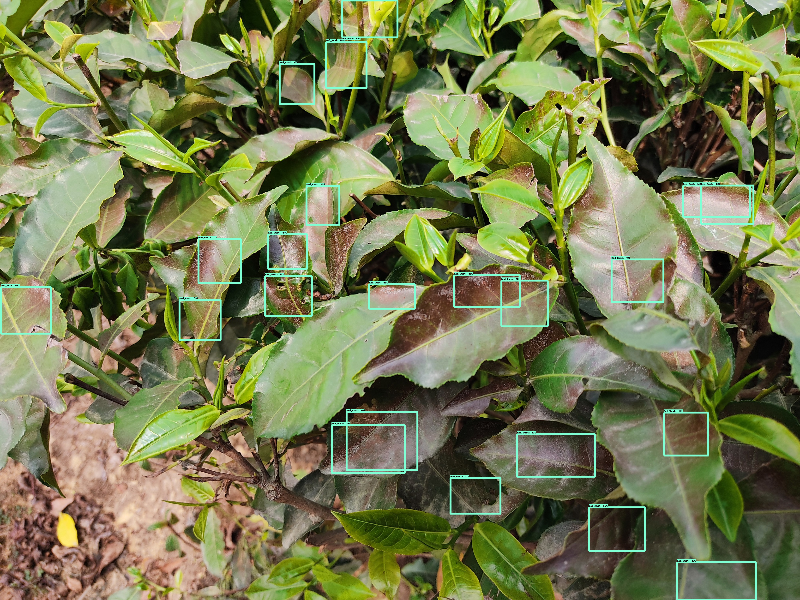

In [ ]:
img = cv2.imread('/content/Red_Spider_Mite_74.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
image_np = np.array(img)
label_id_offset = 1
input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0))
detections = detect_fn(input_tensor)

num_detections = int(detections.pop('num_detections'))
detections = {key: value[0, :num_detections].numpy() for key, value in detections.items()}
detections['num_detections'] = num_detections
print(detections['num_detections'])

# detection_classes should be ints.
detections['detection_classes'] = detections['detection_classes'].astype(np.int64)
print(detections['detection_classes']+label_id_offset)
print(detections['detection_scores'])
# print(detections['detection_boxes'])


image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
  image_np_with_detections,
  detections['detection_boxes'],
  (detections['detection_classes']+label_id_offset).astype(int),
  detections['detection_scores'],
  category_index,
  use_normalized_coordinates=True,
  max_boxes_to_draw=50,
  min_score_thresh=.4,
  line_thickness=8,
  agnostic_mode=False
  )

image_np_with_detections= cv2.cvtColor(image_np_with_detections, cv2.COLOR_RGB2BGR)
cv2_imshow(cv2.resize(image_np_with_detections, (800, 600)))